In [54]:
import sqlite3
import pandas as pd
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import linkage, fcluster

# Connect to SQLite database
db_path = "financial_data.db"
conn = sqlite3.connect(db_path)

# Step 1: Verify available indicators
print("Fetching available indicators...")
query_available_indicators = "SELECT DISTINCT Asset FROM indicators_data;"
available_indicators = pd.read_sql(query_available_indicators, conn)['Asset'].tolist()
print("Available indicators:", available_indicators)

# Filter for relevant indicators (SPY, TAN, VIX) and allow user input for flexibility
relevant_indicators = ['SPY', 'TAN', 'VIX']
selected_indicators = [indicator for indicator in relevant_indicators if indicator in available_indicators]
user_defined_indicators = input("Enter additional indicators (comma-separated) or press Enter to skip: ")
if user_defined_indicators:
    additional_indicators = [indicator.strip() for indicator in user_defined_indicators.split(',')]
    selected_indicators.extend([indicator for indicator in additional_indicators if indicator in available_indicators])
selected_indicators = list(set(selected_indicators))  # Remove duplicates
print("Selected indicators for analysis:", selected_indicators)



Fetching available indicators...
Available indicators: ['ICLN', 'PBW', 'TAN', 'XLE', 'VDE', 'SPY', 'QQQ', 'VIX', 'EEM', 'LIT', 'URA', 'HYG', 'EURUSD=X', 'GBPUSD=X', 'CL=F', 'NG=F', 'DXY', 'GC=F', 'SI=F', '^IRX', '^TNX', '^TYX', 'MSCI', '^FTSE', '^N225', 'BTC-USD', 'ETH-USD']
Enter additional indicators (comma-separated) or press Enter to skip: ICLN, HYG,QQQ
Selected indicators for analysis: ['ICLN', 'SPY', 'HYG', 'TAN', 'VIX', 'QQQ']


In [55]:
# Step 2: Query Solar Data and Indicators
print("Fetching solar and indicator data...")
query_combined = f"""
WITH base_data AS (
    SELECT
        Date,
        Asset,
        Close,
        Volume,
        (High - Low) AS Daily_Range,
        (Close - LAG(Close, 1) OVER (PARTITION BY Asset ORDER BY Date)) / LAG(Close, 1) OVER (PARTITION BY Asset ORDER BY Date) AS Daily_Return
    FROM solar_data
),
rolling_stats AS (
    SELECT
        *,
        AVG(Daily_Return) OVER (PARTITION BY Asset ORDER BY Date ROWS BETWEEN 29 PRECEDING AND CURRENT ROW) AS Avg_Daily_Return,
        COUNT(*) OVER (PARTITION BY Asset ORDER BY Date ROWS BETWEEN 29 PRECEDING AND CURRENT ROW) AS Rolling_Count
    FROM base_data
),
rolling_volatility_calc AS (
    SELECT
        *,
        SUM(POWER(Daily_Return - Avg_Daily_Return, 2)) OVER (PARTITION BY Asset ORDER BY Date ROWS BETWEEN 29 PRECEDING AND CURRENT ROW) AS Sum_Squared_Diffs
    FROM rolling_stats
),
solar_analysis AS (
    SELECT
        Date,
        Asset,
        Close,
        Volume,
        Daily_Range,
        Daily_Return,
        CASE
            WHEN Rolling_Count > 1 THEN CAST(SQRT(Sum_Squared_Diffs / (Rolling_Count - 1)) AS REAL)
            ELSE NULL
        END AS Rolling_Volatility
    FROM rolling_volatility_calc
),
indicator_analysis AS (
    SELECT
        Date,
        Asset AS Indicator,
        Close AS Indicator_Close
    FROM indicators_data
    WHERE Asset IN ({', '.join([f"'{indicator}'" for indicator in selected_indicators])})
)
SELECT
    s.Date, s.Asset, s.Close, s.Volume, s.Daily_Range, s.Daily_Return, s.Rolling_Volatility,
    i.Indicator AS Indicator_Asset, i.Indicator_Close
FROM solar_analysis s
LEFT JOIN indicator_analysis i
ON s.Date = i.Date;
"""
df_combined = pd.read_sql(query_combined, conn)
df_combined['Date'] = pd.to_datetime(df_combined['Date'])

Fetching solar and indicator data...


In [72]:
# Step 3: Visualize Stock Trends with Log Scale
print("Visualizing stock trends...")
fig_stock_trends = px.line(
    df_combined,
    x='Date',
    y='Close',
    color='Asset',
    title="Stock Trends for Solar Companies (Log Scale)",
    labels={"Close": "Closing Price ($)"}
)
fig_stock_trends.update_yaxes(type="log", title="Closing Price (Log Scale)")
fig_stock_trends.show()

Visualizing stock trends...


In [73]:
# Step 4: Rolling Volatility
print("Visualizing rolling volatility...")
fig_volatility = px.line(
    df_combined,
    x='Date',
    y='Rolling_Volatility',
    color='Asset',
    title="30-Day Rolling Volatility Trends",
    labels={"Rolling_Volatility": "Volatility"}
)
fig_volatility.show()

Visualizing rolling volatility...


Analyzing correlations between solar stocks and indicators...


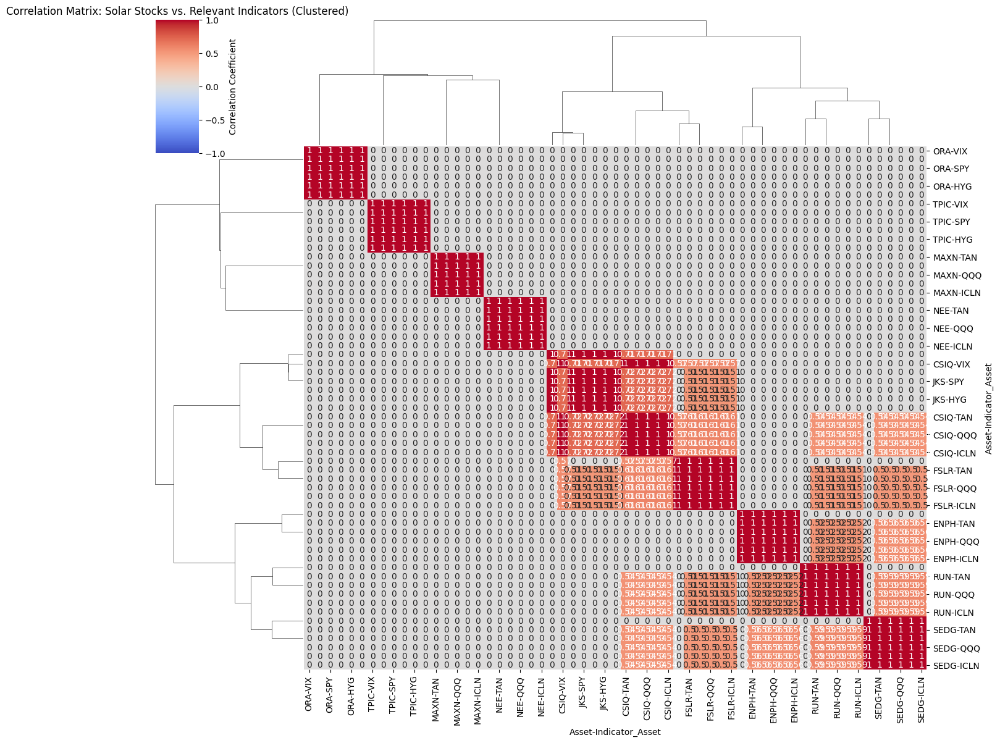

In [58]:
# Step 5: Correlation Heatmap
print("Analyzing correlations between solar stocks and indicators...")
correlation_data = df_combined.pivot_table(
    index='Date',
    columns=['Asset', 'Indicator_Asset'],
    values='Daily_Return'
)

correlation_matrix = correlation_data.corr()

# Filter correlation matrix dynamically based on a threshold
def filter_correlation_matrix(corr_matrix, threshold=0.5):
    return corr_matrix[(corr_matrix >= threshold) | (corr_matrix <= -threshold)].fillna(0)

correlation_matrix = filter_correlation_matrix(correlation_matrix, threshold=0.5)

# Perform clustering for better interpretability
linkage_matrix = linkage(correlation_matrix, method='ward')
cluster_labels = fcluster(linkage_matrix, t=5, criterion='maxclust')

sns.clustermap(
    correlation_matrix, annot=True, cmap='coolwarm', figsize=(14, 12),
    cbar_kws={"label": "Correlation Coefficient", "ticks": [-1, -0.5, 0, 0.5, 1]},
    vmin=-1, vmax=1, method='ward', row_cluster=True, col_cluster=True
)
plt.title("Correlation Matrix: Solar Stocks vs. Relevant Indicators (Clustered)")
plt.show()


In [59]:
# Step 6: Indicator Trends
print("Visualizing trends for indicators and solar stocks...")
fig_indicators = px.line(
    df_combined,
    x='Date',
    y='Indicator_Close',
    color='Indicator_Asset',
    title="Trends of Relevant Market Indicators",
    labels={"Indicator_Close": "Indicator Value"}
)
fig_indicators.show()

fig_solar_vs_indicators = px.line(
    df_combined,
    x='Date',
    y='Close',
    color='Asset',
    facet_col='Indicator_Asset',
    title="Solar Stocks vs. Relevant Indicators (Grouped by Indicator)",
    labels={"Close": "Closing Price ($)"}
)
fig_solar_vs_indicators.show()

Visualizing trends for indicators and solar stocks...


In [60]:
# Step 7: Trading Volume Analysis
# Improved Volume Visualization
print("Analyzing trading volume with improved visualization...")
df_combined['Month'] = df_combined['Date'].dt.to_period('M')

# Aggregate monthly volume for better trends
monthly_volume = df_combined.groupby(['Month', 'Asset'])['Volume'].sum().reset_index()
monthly_volume['Month'] = monthly_volume['Month'].dt.to_timestamp()

fig_volume = px.line(
    monthly_volume,
    x='Month',
    y='Volume',
    color='Asset',
    title="Monthly Trading Volume Trends for Solar Companies",
    labels={"Volume": "Monthly Trading Volume", "Month": "Date"}
)
fig_volume.update_layout(
    xaxis_title="Date",
    yaxis_title="Monthly Trading Volume",
    legend_title="Asset",
    hovermode="x unified"
)
fig_volume.show()


Analyzing trading volume with improved visualization...


In [61]:
# Step 8: Advanced Analysis - Cumulative Returns
print("Visualizing cumulative returns...")
df_combined['Cumulative_Return'] = df_combined.groupby('Asset')['Daily_Return'].cumsum()
fig_cumulative = px.line(
    df_combined,
    x='Date',
    y='Cumulative_Return',
    color='Asset',
    title="Cumulative Returns for Solar Companies",
    labels={"Cumulative_Return": "Cumulative Return"}
)
fig_cumulative.add_annotation(
    x="2020-03-23", y=df_combined['Cumulative_Return'].max(),
    text="Market Crash Recovery Begins",
    showarrow=True, arrowhead=1
)
fig_cumulative.show()



Visualizing cumulative returns...


In [62]:
# Define Bullish and Bearish Markets
print("Identifying bullish and bearish market trends...")

# Add trend labels based on daily returns
trend_threshold = 0.01  # Example: 1% for significant trends
df_combined['Market_Trend'] = df_combined['Daily_Return'].apply(
    lambda x: 'Bullish' if x > trend_threshold else ('Bearish' if x < -trend_threshold else 'Neutral')
)

# Assign colors for trends
trend_colors = {'Bullish': 'green', 'Bearish': 'red', 'Neutral': 'gray'}

# Plot bullish and bearish trends for solar stocks
fig_trends = px.line(
    df_combined,
    x='Date',
    y='Close',
    color='Market_Trend',
    facet_col='Asset',
    title="Bullish and Bearish Market Trends for Solar Companies",
    labels={"Close": "Closing Price ($)", "Date": "Date"},
    color_discrete_map=trend_colors
)
fig_trends.update_layout(
    legend_title="Market Trend",
    hovermode="x unified",
    xaxis_title="Date",
    yaxis_title="Closing Price ($)"
)
fig_trends.show()


Identifying bullish and bearish market trends...


In [65]:
# Verify columns in the combined dataset
print("Available columns in df_combined:")
print(df_combined.columns)

# If Sentiment_Score is missing, simulate dummy data for testing
if 'Sentiment_Score' not in df_combined.columns:
    print("Sentiment_Score column not found. Simulating dummy data...")
    import numpy as np
    df_combined['Sentiment_Score'] = np.random.uniform(low=-1, high=1, size=len(df_combined))
    print("Dummy Sentiment_Score added for testing.")




Available columns in df_combined:
Index(['Date', 'Asset', 'Close', 'Volume', 'Daily_Range', 'Daily_Return',
       'Rolling_Volatility', 'Indicator_Asset', 'Indicator_Close', 'Month',
       'Cumulative_Return', 'Market_Trend'],
      dtype='object')
Sentiment_Score column not found. Simulating dummy data...
Dummy Sentiment_Score added for testing.


In [66]:
# Reshape Data for Sentiment vs. Stock Trends
sentiment_data = df_combined[['Date', 'Asset', 'Close', 'Sentiment_Score']].melt(
    id_vars=['Date', 'Asset'],
    value_vars=['Close', 'Sentiment_Score'],
    var_name='Variable',
    value_name='Value'
)

# Plot Sentiment vs. Stock Trends
fig_sentiment = px.line(
    sentiment_data,
    x='Date',
    y='Value',
    color='Variable',
    facet_col='Asset',
    title="Sentiment vs. Stock Trends (Simulated Sentiment)",
    labels={"Value": "Value", "Date": "Date"}
)
fig_sentiment.show()


In [67]:
# Find most volatile stocks
volatility_ranking = df_combined.groupby('Asset')['Rolling_Volatility'].mean().sort_values(ascending=False)
print("Most volatile stocks:\n", volatility_ranking)


Most volatile stocks:
 Asset
MAXN    0.071142
ENPH    0.048461
TPIC    0.044230
RUN     0.043931
JKS     0.041664
SEDG    0.039903
CSIQ    0.034752
FSLR    0.029164
ORA     0.017884
NEE     0.013324
Name: Rolling_Volatility, dtype: float64


In [68]:
# Normalize prices
df_combined['Normalized_Close'] = df_combined.groupby('Asset')['Close'].transform(lambda x: x / x.iloc[0] * 100)
fig_normalized = px.line(
    df_combined,
    x='Date',
    y='Normalized_Close',
    color='Asset',
    title="Normalized Stock Performance (Base=100)"
)
fig_normalized.show()


In [71]:
conn.close()